In [ ]:
from google.colab import files
uploaded = files.upload()

Saving Datos_materiales1.csv to Datos_materiales1.csv
Saving Datos_materiales2.csv to Datos_materiales2.csv
Saving Datos_materiales3.csv to Datos_materiales3.csv
Saving Datos_materiales4.csv to Datos_materiales4.csv
Saving Datos_materiales5.csv to Datos_materiales5.csv
Saving Datos_materiales6.csv to Datos_materiales6.csv
Saving Datos_materiales7.csv to Datos_materiales7.csv
Saving Datos_materiales8.csv to Datos_materiales8.csv
Saving Datos_materiales9.csv to Datos_materiales9.csv
Saving Datos_materiales10.csv to Datos_materiales10.csv
Saving Datos_materiales11.csv to Datos_materiales11.csv


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


**MLP Generación de biomateriales**

Importe de librerias tensorflow, sklearn, numpy

In [ ]:
! pip install tensorflow
! pip install --upgrade scikit-learn

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.3/13.3 MB 75.7 MB/s eta 0:00:00
  Attempting uninstall: scikit-learn
    Found existing installation: scikit-learn 1.2.2
    Uninstalling scikit-learn-1.2.2:
      Successfully uninstalled scikit-learn-1.2.2


**Importar librerias**

In [ ]:
import numpy as np
import pandas as pd
from scipy.stats import rankdata
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.neural_network import MLPRegressor
from sklearn.metrics import accuracy_score
from sklearn.compose import make_column_transformer
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import GridSearchCV
from sklearn.tree import export_graphviz
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn import preprocessing

import random

**Actualmente se usa esta forma de generar datos, con lo que se logro llegar a buenas metricas dado los datos generados.**

In [ ]:
import numpy as np
import pandas as pd
import random

# Lista de materiales reales
materiales_reales = [
    "Acero", "Aluminio", "Cobre", "Polietileno", "Polipropileno",
    "Nylon", "Cerámica", "Vidrio", "Titanio", "PVC",
    "Bronce", "Zinc", "Oro", "Plata", "Hormigón"
]

# lista de nombres de caracteristicas relevantes para biomateriales (a priori)
nombres_caracteristicas = ['mod_elasticidad_aproximado_Mpsi',
       'Res_max_tension_kpsi', 'Res_max_comp_kpsi','densidad', 'coef_fric']

# generar datos de distribucion para materiales reales
muestras = 800
num_caract = len(nombres_caracteristicas)
mean = [9.30, 82, 28.74, 10.2,0.24]
std_dev = [3.05, 47, 21.65, 5.14, 0.14]

material_caract = np.random.normal(mean, std_dev, size=(muestras, num_caract))

# Aplicar np.clip() para evitar valores negativos
material_caract = np.clip(material_caract, 0, None)

# asignar materiales reales aleatoriamente
materiales_asignados = [random.choice(materiales_reales) for _ in range(muestras)]

# Crear dataframe para materiales reales
materials_df = pd.DataFrame(material_caract, columns=nombres_caracteristicas)
materials_df['Material'] = materiales_asignados
materials_df['Tipo'] = 0  # Etiqueta como no biomaterial

# Generar datos de biomateriales
muestras_biomat = 1600
biomaterial_prop = np.random.normal(mean, std_dev, size=(muestras_biomat, num_caract))

# Aplicar np.clip() para evitar valores negativos
biomaterial_prop = np.clip(biomaterial_prop, 0, None)

materiales_asignados_biomat = []

for _ in range(muestras_biomat):
    # seleccionar al azar varios materiales individuales
    num_material = random.randint(2, 5)
    sel_mat = random.sample(materiales_reales, num_material)

    # Ponderar las características por un valor o peso para generar la "mezcla"
    weights = np.random.rand(num_material)
    weights /= weights.sum()

    biomaterial_caract = np.zeros(num_caract)
    for i, material in enumerate(sel_mat):
        material_data = materials_df[materials_df['Material'] == material][nombres_caracteristicas].values[0]
        biomaterial_caract += weights[i] * material_data

    materiales_asignados_biomat.append("_".join(sel_mat))

biomaterials_df = pd.DataFrame(biomaterial_prop, columns=nombres_caracteristicas)
biomaterials_df['Material'] = materiales_asignados_biomat
biomaterials_df['Tipo'] = 1  # etiqueta como biomaterial


combined_data = pd.concat([materials_df, biomaterials_df], ignore_index=True)

combined_data.to_csv('combined_data.csv', index=False)

print(combined_data.head())

   mod_elasticidad_aproximado_Mpsi  Res_max_tension_kpsi  Res_max_comp_kpsi  \
0                         8.710814             49.208529           8.164484   
1                        11.225912             47.147736           1.948332   
2                         6.640127             67.140012          18.327245   
3                        10.307967            192.116244          22.031430   
4                        10.513195             12.236061          39.142175   

    densidad  coef_fric Material  Tipo  
0  22.322515   0.000000      PVC     0  
1  13.333777   0.417301    Acero     0  
2   3.175270   0.342822    Acero     0  
3  11.424388   0.211357    Cobre     0  
4   5.748487   0.196603      PVC     0  


In [ ]:
import numpy as np
import pandas as pd
import random

# Lista de materiales reales
materiales_reales = [
    "Acero", "Aluminio", "Cobre", "Polietileno", "Polipropileno",
    "Nylon", "Cerámica", "Vidrio", "Titanio", "PVC",
    "Bronce", "Zinc", "Oro", "Plata", "Hormigón"
]

# Lista de nombres de características relevantes para biomateriales (a priori)
nombres_caracteristicas = ['mod_elasticidad_aproximado_Mpsi',
       'Res_max_tension_kpsi', 'Res_max_comp_kpsi','densidad', 'coef_fric']

# Generar datos de distribución para materiales reales
muestras = 100
num_caract = len(nombres_caracteristicas)
mean = [9.30, 82, 28.74, 10.2, 0.24]
std_dev = [3.05, 47, 21.65, 5.14, 0.14]

material_caract = np.random.normal(mean, std_dev, size=(muestras, num_caract))

# Aplicar np.clip() para evitar valores negativos
material_caract = np.clip(material_caract, 0, None)

# asignar materiales reales aleatoriamente
materiales_asignados = [random.choice(materiales_reales) for _ in range(muestras)]

# crear DataFrame para materiales reales
materials_df = pd.DataFrame(material_caract, columns=nombres_caracteristicas)
materials_df['Material'] = materiales_asignados
materials_df['Tipo'] = 0  # Etiqueta como no biomaterial

# generar datos de biomateriales relacionados
muestras_biomat = 200
biomaterial_prop = np.random.normal(mean, std_dev, size=(muestras_biomat, num_caract))

# Aplicar np.clip() para evitar valores negativos
biomaterial_prop = np.clip(biomaterial_prop, 0, None)

materiales_asignados_biomat = []

for _ in range(muestras_biomat):
    # Seleccionar al azar varios materiales individuales
    num_material = random.randint(2, 5)
    sel_mat = random.sample(materiales_reales, num_material)

    # ponderar las características por un valor o peso aleatorio para generar la "mezcla"
    weights = np.random.rand(num_material)
    weights /= weights.sum()

    biomaterial_caract = np.zeros(num_caract)
    for i, material in enumerate(sel_mat):
        material_data = materials_df[materials_df['Material'] == material][nombres_caracteristicas].values[0]
        biomaterial_caract += weights[i] * material_data

    materiales_asignados_biomat.append("_".join(sel_mat))

# Crear fataframe para biomateriales
biomaterials_df = pd.DataFrame(biomaterial_prop, columns=nombres_caracteristicas)
biomaterials_df['Material'] = materiales_asignados_biomat
biomaterials_df['Tipo'] = 1  # Etiqueta como biomaterial

# se introducen las correlaciones
correlation_factor_tension_comp = np.random.normal(1, 0.1, muestras_biomat)
biomaterials_df['Res_max_comp_kpsi'] = biomaterials_df['Res_max_tension_kpsi'] * correlation_factor_tension_comp

correlation_factor_densidad_tension = np.random.normal(0.5, 0.2, muestras_biomat)
biomaterials_df['Res_max_tension_kpsi'] = biomaterials_df['densidad'] * correlation_factor_densidad_tension

correlation_factor_densidad_coef_fric = np.random.normal(0.1, 0.05, muestras_biomat)
biomaterials_df['coef_fric'] = biomaterials_df['densidad'] * correlation_factor_densidad_coef_fric

correlation_factor_densidad_coef_fric = np.random.normal(0.3, 0.1, muestras_biomat)
biomaterials_df['mod_elasticidad_aproximado_Mpsi'] = biomaterials_df['densidad'] * correlation_factor_densidad_coef_fric


correlation_factor_coef_fric_densidad = np.random.normal(0.5, 0.1, muestras_biomat)
biomaterials_df['coef_fric'] = biomaterials_df['densidad'] * correlation_factor_coef_fric_densidad

#combinar ambos dataframes
combined_data = pd.concat([materials_df, biomaterials_df], ignore_index=True)

#guardar el archivo CSV con la columna Tipo añadida
combined_data.to_csv('combined_data.csv', index=False)

print(combined_data.head())


   mod_elasticidad_aproximado_Mpsi  Res_max_tension_kpsi  Res_max_comp_kpsi  \
0                        12.236812             79.929848          16.198508   
1                        10.437066              0.580007           9.917542   
2                         9.391495             24.472150          31.404628   
3                         8.999349            144.537420          51.144085   
4                        10.420575             57.237471          52.604423   

    densidad  coef_fric Material  Tipo  
0   9.081107   0.406181    Acero     0  
1  11.252084   0.448160   Bronce     0  
2   6.017738   0.057767  Titanio     0  
3   6.955695   0.293516    Cobre     0  
4  11.899259   0.250722      Oro     0  


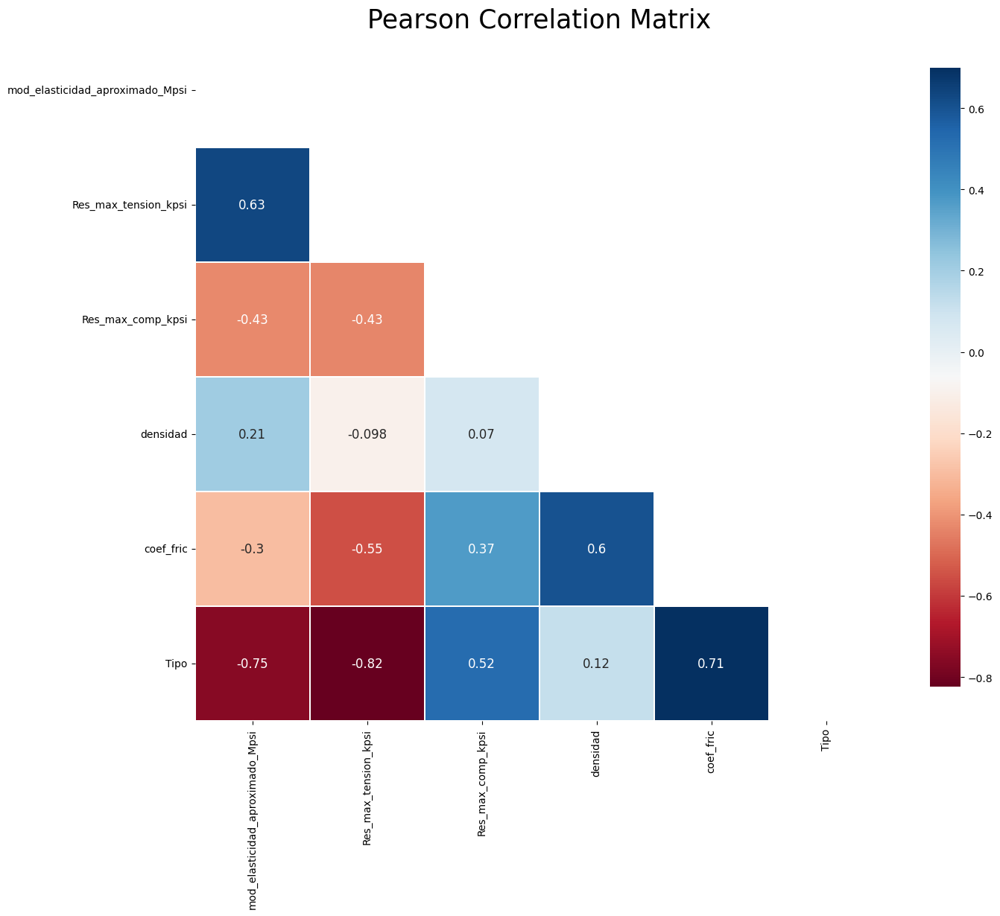

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
data = pd.read_csv('combined_data.csv')

numerical_data = data.select_dtypes(include=[np.number])
mask = np.zeros_like(numerical_data.corr(), dtype=bool)
mask[np.triu_indices_from(mask)] = True

f, ax = plt.subplots(figsize=(16, 12))
plt.title('Pearson Correlation Matrix',fontsize=25)

sns.heatmap(numerical_data.corr(),linewidths=0.25,vmax=0.7,square=True,cmap="RdBu",
            linecolor='w',annot=True,annot_kws={"size":12},mask=mask,cbar_kws={"shrink": .9});

Genera datos a partir de un csv que esta cargado en el drive, de esa manera puede generar a partir de la distribucion de esa tabla de datos.

In [ ]:
import pandas as pd
import numpy as np

# Lee los datos reales
data_real = pd.read_csv('dataset2.csv', sep=';', skipinitialspace=True)


# Columnas de interes
col = ['Material', 'mod_elasticidad_aproximado_Mpsi', 'mod_elasticidad_aproximado_Gpa',
       'Res_max_tension_kpsi', 'Res_max_tension_Mpa', 'Res_max_comp_kpsi',
       'Res_max_comp_Mpa']
for columna in col[1:]:
    data_real[columna] = pd.to_numeric(data_real[columna], errors='coerce')

# Calcula la media y la desviacion estandar de las columnas
media_real = data_real[col[1:]].mean()
desviacion_estandar_real = data_real[col[1:]].std()

size = 3200
muestras_biomat =6400
materiales_reales = data_real['Material'].tolist()
nombres_caracteristicas = col[1:]

# Genera datos sinteticos para materiales individuales, incluyendo la columna 'Material'
datos_sinteticos = {
    columna: np.abs(np.random.normal(media_real[columna], desviacion_estandar_real[columna], size))
    for columna in col[1:]
}
datos_sinteticos['Material'] = [f"mat{i + 20:02d}" for i in range(size)]
df_sintetico_materiales = pd.DataFrame(datos_sinteticos)

materiales_asignados_biomat = []

# Genera datos sinteticos para biomateriales (mezcla ponderada de caracteristicas de materiales individuales)
df_sintetico_biomateriales = pd.DataFrame(columns=col)  # dataframe vacio para biomateriales

for _ in range(muestras_biomat):
    #seleccionar al azar varios materiales individuales
    num_material = random.randint(2, 5)
    sel_mat = random.sample(materiales_reales, num_material)

    # Ponderar las características por un valor o peso para generar la "mezcla"
    weights = np.random.rand(num_material)
    weights /= weights.sum()

    biomaterial_caract = np.zeros(len(nombres_caracteristicas))
    for i, material in enumerate(sel_mat):
        material_data = data_real[data_real['Material'] == material][nombres_caracteristicas].values[0]
        biomaterial_caract += weights[i] * material_data

    materiales_asignados_biomat.append("_".join(sel_mat))

    datos_sinteticos_biomaterial = {
        columna: biomaterial_caract[idx]
        for idx, columna in enumerate(nombres_caracteristicas)
    }
    datos_sinteticos_biomaterial['Material'] = f"bio{_ + 1:02d}"
    df_temp_biomaterial = pd.DataFrame([datos_sinteticos_biomaterial])


    df_temp_biomaterial['Tipo'] = 1


    df_sintetico_biomateriales = pd.concat([df_sintetico_biomateriales, df_temp_biomaterial], ignore_index=True)

df_combinado = pd.concat([data_real[col], df_sintetico_materiales[col], df_sintetico_biomateriales[col]], axis=0)

df_combinado['Tipo'] = pd.concat([pd.Series([0]*len(data_real)), pd.Series([0]*len(df_sintetico_materiales)), pd.Series([1]*len(df_sintetico_biomateriales))], ignore_index=True)

df_combinado.to_csv('datos_combinados.csv', index=False)

print(df_combinado.head())
print(len(df_combinado))

                              Material  mod_elasticidad_aproximado_Mpsi  \
0                                  ABS                              0.3   
1     ABS cargado con 20-40% de vidrio                              0.6   
2                               Acetal                              0.5   
3  Acetal cargado con 20-30% de vidrio                              1.0   
4                             Acrílico                              0.4   

   mod_elasticidad_aproximado_Gpa  Res_max_tension_kpsi  Res_max_tension_Mpa  \
0                             2.1                   6.0                 41.4   
1                             4.1                  10.0                 68.9   
2                             3.4                   8.8                 60.7   
3                             6.9                  10.0                 68.9   
4                             2.8                  10.0                 68.9   

   Res_max_comp_kpsi  Res_max_comp_Mpa  Tipo  
0               10.0 

In [ ]:
materials1_df = pd.read_csv('datos_combinados.csv')
materials2_df = pd.read_csv('combined_data.csv')
df_combinado_final = pd.concat([materials1_df, materials2_df], ignore_index=True)
df_combinado_final.to_csv('recombined_data.csv', index=False)
print(df_combinado_final.head())

                              Material  mod_elasticidad_aproximado_Mpsi  \
0                                  ABS                              0.3   
1     ABS cargado con 20-40% de vidrio                              0.6   
2                               Acetal                              0.5   
3  Acetal cargado con 20-30% de vidrio                              1.0   
4                             Acrílico                              0.4   

   mod_elasticidad_aproximado_Gpa  Res_max_tension_kpsi  Res_max_tension_Mpa  \
0                             2.1                   6.0                 41.4   
1                             4.1                  10.0                 68.9   
2                             3.4                   8.8                 60.7   
3                             6.9                  10.0                 68.9   
4                             2.8                  10.0                 68.9   

   Res_max_comp_kpsi  Res_max_comp_Mpa  Tipo  densidad  coef_fric  


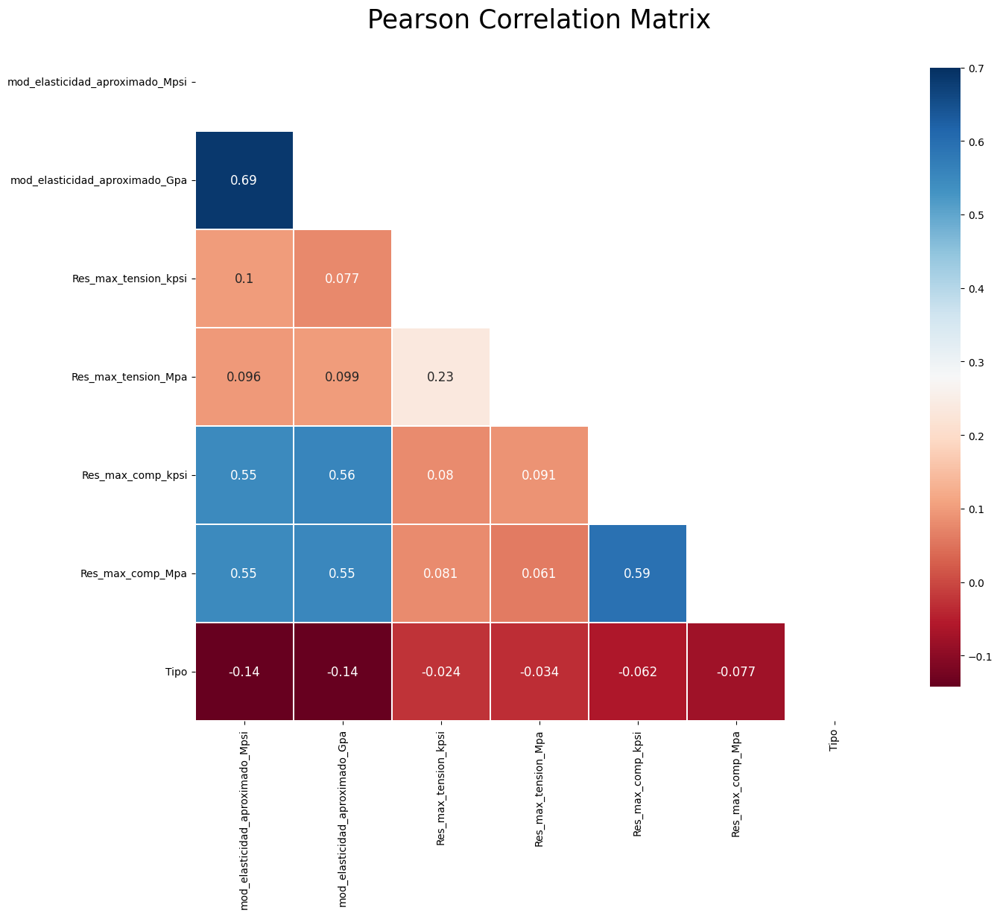

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
data = dat

numerical_data = data.select_dtypes(include=[np.number])

mask = np.zeros_like(numerical_data.corr(), dtype=bool)
mask[np.triu_indices_from(mask)] = True

f, ax = plt.subplots(figsize=(16, 12))
plt.title('Pearson Correlation Matrix',fontsize=25)

sns.heatmap(numerical_data.corr(),linewidths=0.25,vmax=0.7,square=True,cmap="RdBu",
            linecolor='w',annot=True,annot_kws={"size":12},mask=mask,cbar_kws={"shrink": .9});

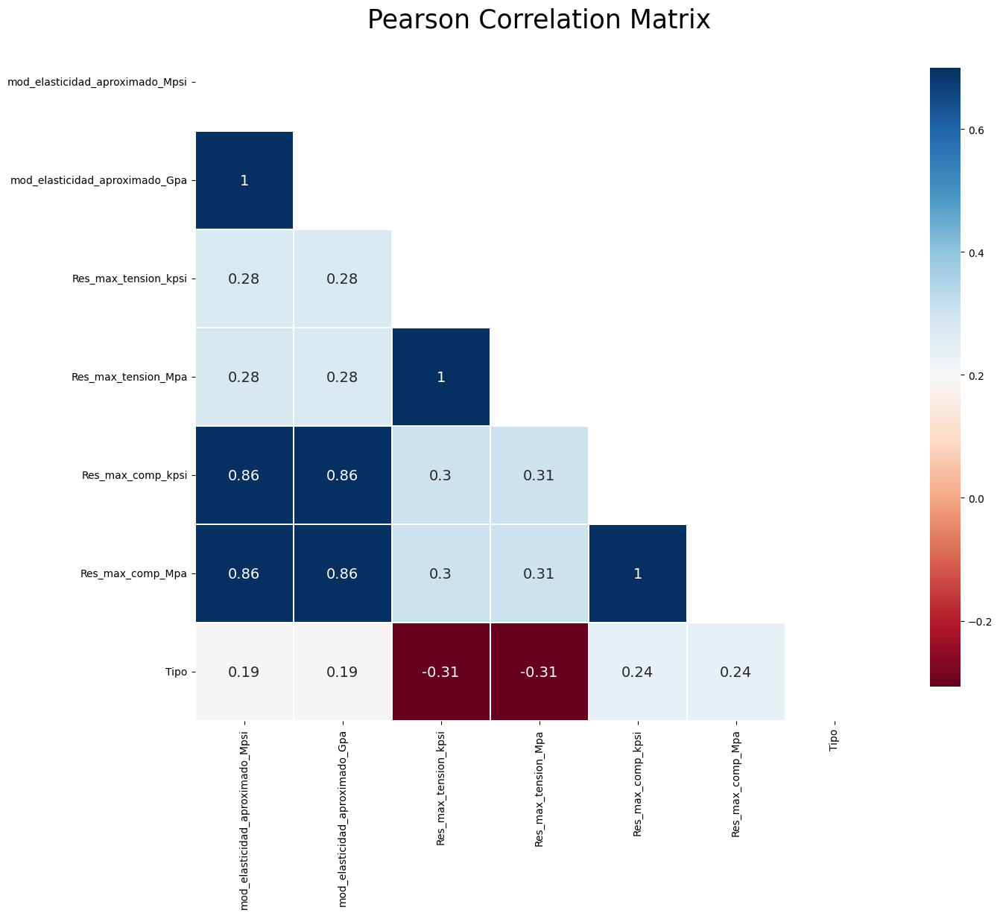

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

data = pd.read_csv('dataset2.csv', sep=';', skipinitialspace=True)

data['Res_max_comp_kpsi'] = pd.to_numeric(data['Res_max_comp_kpsi'], errors='coerce')
data['Res_max_comp_Mpa'] = pd.to_numeric(data['Res_max_comp_Mpa'], errors='coerce')


numerical_data = data.select_dtypes(include=[np.number])


if numerical_data.empty:
    print("Warn")
else:
    mask = np.zeros_like(numerical_data.corr(), dtype=bool)
    mask[np.triu_indices_from(mask)] = True

    f, ax = plt.subplots(figsize=(16, 12))
    plt.title('Pearson Correlation Matrix',fontsize=25)

    sns.heatmap(numerical_data.corr(),linewidths=0.25,vmax=0.7,square=True,cmap="RdBu",
                linecolor='w',annot=True,annot_kws={"size":14},mask=mask,cbar_kws={"shrink": .9});
    plt.show()

In [ ]:
colum = ['Material']

encoder = OneHotEncoder(sparse=False, drop='first')

preprocessor = ColumnTransformer(
    transformers=[('cat', encoder, colum)],
    remainder='passthrough'
)

encoded = preprocessor.fit_transform(data)
encoded_df = pd.DataFrame(encoded, columns=preprocessor.get_feature_names_out())

data_encoded = pd.concat([data, encoded_df], axis=1)
print(len(data_encoded))

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:975: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(


InvalidIndexError: Reindexing only valid with uniquely valued Index objects

In [ ]:
target_columns = ['mod_elasticidad_aproximado_Mpsi', 'mod_elasticidad_aproximado_Gpa']

X = data_encoded.drop(columns=target_columns + ['Material']).values
y = data_encoded[target_columns].values #variables objetivo

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)
print(np.isnan(y_test).sum())


0


In [ ]:
mask = ~np.isnan(X_train).any(axis=1)
X_train = X_train[mask]
y_train = y_train[mask]
print(np.isnan(X_train).sum())

0


In [ ]:
from sklearn.impute import SimpleImputer
imputer = SimpleImputer(strategy='mean') #rellenar valores faltantes en caso de existir con el promedio
X_train_imputed = imputer.fit_transform(X_train)
X_test_imputed = imputer.transform(X_test)

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train_imputed)
X_test_scaled = scaler.transform(X_test_imputed)

In [ ]:
model = MLPRegressor(hidden_layer_sizes=(15,10,5), activation='relu', max_iter=1000, random_state=42)
model.fit(X_train_scaled, y_train)

MLPRegressor(hidden_layer_sizes=(15, 10, 5), max_iter=1000, random_state=42)

In [ ]:
y_pred = model.predict(X_test_scaled)

Haciendo una mezcla entre los valores generados de manera totalmente sintetica y los valores generados a partir de la distribucion de los datos reales se obtienen muy buenos resultados. Este es el camino correcto.

In [ ]:
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
print(f'MSE: {mse:.2f}')
print(f'R2: {r2:.2f}')

MSE: 697.75
R2: -1.15


In [ ]:
hidden_layer_configurations = [
    (10),(10,10),(20),(30),(40), (50), (60), (64,32) , (100,), (200,), (300,),
    (100, 50), (200, 100), (300, 150),
    (100, 50, 25), (200, 100, 50), (300, 150, 75), (350,100), (400,100),(500,100),(1000),(1500),(2000), (3000)
]


results = []

for config in hidden_layer_configurations:

    model = MLPRegressor(hidden_layer_sizes=config, activation='relu', max_iter=2000, random_state=42)

    model.fit(X_train_scaled, y_train)

    y_pred = model.predict(X_test_scaled)

    mse = mean_squared_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)

    results.append({
        'hidden_layers': config,
        'MSE': mse,
        'R2': r2
    })


results_df = pd.DataFrame(results)


results_df.to_csv('results_clusters.csv', sep=',', index=False)


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (2000) reached and the optimization hasn't converged yet.
  warnings.warn(


Los resultados han sido guardados en 'results.csv'


In [ ]:
print(y_pred)
column_names = ['mod_elasticidad_aproximado_Mpsi','Res_max_tension_Mpa']
y_pred_df = pd.DataFrame(data=y_pred, columns=column_names)
y_pred_df.to_csv('resultados_prediccion.csv', index=False)

[[ 4.76409757 14.39824308]
 [ 0.27241771  4.22428774]
 [ 3.42171403 10.86331954]
 [11.64697616  8.01783498]
 [ 4.72907443 13.78381854]
 [ 3.95503418 14.70983616]
 [ 2.45162713 11.68002618]
 [ 2.36545886 10.11866956]
 [10.86515161  9.02322467]
 [ 5.03745209 15.45636753]
 [ 4.94760441 15.73031043]
 [14.9258087  11.57364801]
 [ 2.18490243 11.04672399]
 [ 8.88532415 13.95150741]
 [ 2.42077844  8.97463989]
 [ 5.76198359 17.95731964]
 [-0.09479556  1.14227655]
 [ 0.52846337  3.52840784]
 [ 0.56606678  5.80910617]
 [-0.09158858  2.78796296]
 [ 5.62581837 17.03431168]
 [ 7.7176979  25.16121751]
 [ 0.72436968  6.63002776]
 [ 4.32148197 15.99331773]
 [ 3.33645313 14.39515766]
 [ 6.10187315 11.24144108]
 [ 4.13774941 15.68169664]
 [ 2.22228899  8.48655157]
 [ 7.69253546 22.35939981]
 [ 3.35736924 12.98968014]
 [ 8.68234645  4.88661049]
 [ 3.32418996 13.27591271]
 [ 9.53622924 17.37597041]
 [13.21721456  8.34751611]
 [ 4.59062609 18.44350191]
 [ 3.15928338 10.69290274]
 [11.57239781  1.13247647]
 

In [ ]:
param_grid = {
    'hidden_layer_sizes':  [(10),(20),(30),(40),(50),(60),(70),(80),(90),(100),(64,32),(10,10,10),(100,64),(100,64,64),(100,64,100)],
    'alpha': [0.0001, 0.001],
    'max_iter': [10000],
    'learning_rate_init': [0.001, 0.01]
}

grid_search = GridSearchCV(MLPRegressor(random_state=42), param_grid, cv=3, scoring='neg_mean_squared_error')

grid_search.fit(X_train_scaled, y_train)

best_params = grid_search.best_params_
best_model = grid_search.best_estimator_

y_pred = best_model.predict(X_test_scaled)

mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print("Mejores hiperparámetros:", best_params)
print("Error Cuadrático Medio (MSE) con mejores hiperparámetros:", mse)
print("Coeficiente de Determinación (R2) con mejores hiperparámetros:", r2)

Mejores hiperparámetros: {'alpha': 0.001, 'hidden_layer_sizes': (100, 64), 'learning_rate_init': 0.01, 'max_iter': 10000}
Error Cuadrático Medio (MSE) con mejores hiperparámetros: 11.169045331780717
Coeficiente de Determinación (R2) con mejores hiperparámetros: 0.4662995293667422


In [ ]:
!pip install plotly


In [ ]:
import plotly.graph_objects as go
from sklearn.neural_network import MLPRegressor

input_size = X_train_scaled.shape[1]
output_size = y_train.shape[1]
hidden_layer_sizes = (64, 32)

model = MLPRegressor(hidden_layer_sizes=hidden_layer_sizes, activation='relu', max_iter=1000, random_state=42)
model.fit(X_train_scaled, y_train)

architecture = [input_size] + list(hidden_layer_sizes) + [output_size]

fig = go.Figure()

for layer_idx, layer_size in enumerate(architecture):
    for node_idx in range(layer_size):
        node_name = f'Layer {layer_idx + 1} Node {node_idx + 1}'
        fig.add_trace(go.Scatter(x=[layer_idx], y=[node_idx], mode='markers', marker=dict(size=20), name=node_name))


for layer_idx in range(len(architecture) - 1):
    for from_node in range(architecture[layer_idx]):
        for to_node in range(architecture[layer_idx + 1]):
            from_name = f'Layer {layer_idx + 1} Node {from_node + 1}'
            to_name = f'Layer {layer_idx + 2} Node {to_node + 1}'
            fig.add_trace(go.Scatter(x=[layer_idx, layer_idx + 1], y=[from_node, to_node], mode='lines', line=dict(width=1), name=f'{from_name} to {to_name}'))

fig.update_layout(title_text='Arquitectura de la Red Neuronal', showlegend=False, xaxis=dict(title='Capa'), yaxis=dict(title='Nodo'))

fig.show()

